In [1]:
import torch
import numpy as np
import load_data
import pickle
import network
import torch.optim as optim
from torch.autograd import Variable
#from trainer_tester import train, validate
from torch.optim.lr_scheduler import ReduceLROnPlateau
import random
import torch.nn as nn
import load_data
import matplotlib.pyplot as plt
import loss as criteria
import util

In [2]:
class YoloDataset(torch.utils.data.Dataset):
  'Characterizes a dataset for PyTorch'
  def __init__(self, list_IDs, labels, gt_raws, resize_factor = 0.8):
        'Initialization'
        self.labels = labels
        self.list_IDs = list_IDs
        self.resize_factor = resize_factor
        self.gt_raws = gt_raws

  def __len__(self):
        'Denotes the total number of samples'
        return len(self.list_IDs)

  def __getitem__(self, index):
        # Select samples
        ID = self.list_IDs[index]

        # Load data and get label
        X = images[ID].reshape(3, int(480 * self.resize_factor), int(640 * self.resize_factor))
        y = self.labels[ID]
        gt_raw = self.gt_raws[ID]
        
        return torch.tensor(X, dtype=torch.uint8), y, gt_raw

In [3]:
device = torch.device("cuda:0")
resize_factor = 0.8
load_img_from_file = False
load_from_file = False
batch_size = 32
thresh = 0.5

In [9]:
def avg_IoU(output, ground_truth, return_box = False):
    co_mask = ground_truth[:,:,:,4] > 0
    co_mask = co_mask.unsqueeze(-1).expand_as(ground_truth)

    co_out = output[co_mask].view(-1,14)                    
    co_gt = ground_truth[co_mask].view(-1,14)
    gt_box = co_gt[:,:10].contiguous().view(-1,5)
    out_box = co_out[:,:10].contiguous().view(-1,5) 
#     zero_h_mask = out_box[:, 2] < 0  # Deal with neg height and width value
#     zero_w_mask = out_box[:, 3] < 0
#     out_box[zero_h_mask, 2] = 0
#     out_box[zero_w_mask, 3] = 0 

    IoUs = torch.zeros([gt_box.size()[0] // 2, 1])

    for i in range(0, gt_box.size()[0], 2):
        box1 = out_box[i:i + 1]
        box2 = out_box[i + 1:i + 2]
        box_ground = gt_box[i]
        IoU_pair = torch.zeros([1, 2]).cuda()
        IoU_pair[0, 0] = util.IoU(box1, box_ground)
        IoU_pair[0, 1] = util.IoU(box2, box_ground)
        max_IoU, max_idx = IoU_pair.max(1)
        IoUs[i // 2, 0] = max_IoU
    
        
#     print(out_box)
#     print(gt_box)
#     print()
    
    return torch.sum(IoUs) / output.size()[0]


def compute_mAP(output, ground_truth, threshold = thresh):
    conf_scores = torch.zeros([output.size()[0], 1])
    out_box = torch.zeros([output.size()[0], 5])
    #gt_box = torch.zeros([output.size()[0], 5])
    IoUs = torch.zeros([output.size()[0], 1])
    num_pos_boxes = 0

    for i in range(output.size()[0]):
        thresh_mask1 = output[i, :, :, 4] > threshold
        thresh_mask2 = output[i, :, :, 9] > threshold
        thresh_mask1 = thresh_mask1.unsqueeze(-1).expand_as(output[i, :, :, :])
        thresh_mask2 = thresh_mask2.unsqueeze(-1).expand_as(output[i, :, :, :])
        
        co_out1 = output[i, thresh_mask1].view(-1,14)                    
        co_gt1 = ground_truth[i, thresh_mask1].view(-1,14)
        gt_box1 = co_gt1[:,:5].contiguous().view(-1,5)
        out_box1 = co_out1[:,:5].contiguous().view(-1,5) 
        
        co_out2 = output[i, thresh_mask2].view(-1,14)                    
        co_gt2 = ground_truth[i, thresh_mask2].view(-1,14)
        gt_box2 = co_gt2[:,5:10].contiguous().view(-1,5)
        out_box2 = co_out2[:,5:10].contiguous().view(-1,5) 

        num_pos_boxes += out_box1.size()[0] + out_box2.size()[0]
        
        for j in range(0, gt_box1.size()[0]):
            box1 = out_box1[j]
            box_ground = gt_box1[j]
            if box_ground[4] == 0:
                IoUs[i] = 0
            else:
                IoU = util.IoU(box1, box_ground).cpu()
                IoUs[i] = torch.max(IoU, IoUs[i])#util.IoU(box1, box_ground) #Warning: for Pytorch 1.2 only. Use torch.maximum for 1.8.
                #print('%.4f, %.4f' % (box1[4].item(), IoUs[i].item()))
                
        
        for j in range(0, gt_box2.size()[0]):
            box1 = out_box2[j]
            box_ground = gt_box2[j]
            if box_ground[4] == 0:
                IoUs[i] = 0
            else:
                IoU = util.IoU(box1, box_ground).cpu()
                IoUs[i] = torch.max(IoU, IoUs[i])
                #print(box1[4])
                #print('%.4f, %.4f' % (box1[4].item(), IoUs[i].item()))
            
    #print(torch.sum(IoUs).item() / output.size()[0])
    if num_pos_boxes == 0:
        return 0
    return torch.sum(IoUs > threshold).item() / num_pos_boxes  #TP / (TP + FP)

def check_class_accu(output, ground_truth): 
    '''
    Returns # of correct class predictions in the output.
    '''
    co_mask = ground_truth[:,:,:,4] > 0
    co_mask = co_mask.unsqueeze(-1).expand_as(ground_truth)

    co_out = output[co_mask].view(-1,14)                    
    co_gt = ground_truth[co_mask].view(-1,14)

    co_out = co_out[:, 10:14]
    co_gt = co_gt[:, 10:14]
    
    temp, out_class = torch.max(co_out, dim=1)
    temp, gt_class = torch.max(co_gt, dim=1)
    compare = out_class == gt_class
    
    return torch.sum(compare)

def find_boxes_for_show(output, threshold = 0.25):
    #Multiple input
    if len(output.size()) == 4:
        pass
#         out_box = torch.zeros([output.size()[0], 5])
#         out_box_grid = torch.zeros([output.size()[0], 2])
#         conf_scores = torch.zeros([output.size()[0], 1])

#         for i in range(output.size()[0]):
#             max_conf1 = torch.max(output[i, :, :, 4])
#             max_conf2 = torch.max(output[i, :, :, 9])
#             max_conf1_idx = [torch.argmax(output[i, :, :, 4]) // 8, torch.argmax(output[i, :, :, 4]) % 8]
#             max_conf2_idx = [torch.argmax(output[i, :, :, 9]) // 8, torch.argmax(output[i, :, :, 9]) % 8]

#             if (max_conf1 >= max_conf2):
#                 conf_scores[i, 0] = max_conf1
#                 out_box[i, :] = output[i, max_conf1_idx[0].int(), max_conf1_idx[1].int(), 0:5]
#                 out_box_grid[i, :] = max_conf_1_idx
#             else:
#                 conf_scores[i, 0] = max_conf2
#                 out_box[i, :] = output[i, max_conf2_idx[0].int(), max_conf2_idx[1].int(), 5:10]
#                 out_box_grid[i, :] = max_conf_2_idx

#         return out_box, out_box_grid, conf_scores
    #Single input
    else:
        boxes = list()
        for i in range(output.size()[0]):
            for j in range(output.size()[1]):
                cell = output[i, j, :].view(1, 14)
                #temp, out_class = torch.max(cell[:, 10:14])
                out_class = torch.argmax(cell[:, 10:14])
                grid_coord = torch.Tensor([[i, j]])
                if cell[0, 4] > threshold:
                    boxes.append((cell[0, 0:5], grid_coord, out_class))
                if cell[0, 9] > threshold:
                    boxes.append((cell[0, 5:10], grid_coord, out_class))
        return boxes
        
def train(args, model, device, train_loader, optimizer, scheduler, epoch, val_loader, print_every, val_every):
    model = model.to(device=device)
    losses = list()
    IoUs = list()
    val_IoUs = list()
    val_mAPs = list()
    accuracies = list()
    val_accuracies = list()
    for ep in range(epoch):
        model.train()
        total_loss = 0

        for batch_idx, (data, target, gt_raw) in enumerate(train_loader):
            target = Variable(target)
            data, target = data.to(device=device, dtype=torch.float32), target.to(device=device)
            optimizer.zero_grad()
            output = model(Variable(data))

            criterion = criteria.YoloLoss()
            loss = criterion(output, target)#torch.max(target, dim=1)[1])
            loss.backward()
            optimizer.step()

            IoU = avg_IoU(output, target)
            #mAP = compute_mAP(output, target)
            IoUs.append(IoU.item())
            #mAPs.append(mAP)
            
            if batch_idx % print_every == 0:
                accu = check_class_accu(output, target)
                accu = accu.item() / batch_size
                accuracies.append(accu)
                print('Epoch %d Iter %d IoU = %.5f, Accu = %.5f, Loss = %.5f' % (
                      ep, batch_idx, IoU.item(), accu, loss.item()))
                
            if (batch_idx + 1) % val_every == 0:
                (val_IoU, val_mAP, val_accu) = validate('', model, device, val_loader)
                val_IoUs.append(val_IoU.item())
                val_mAPs.append(val_mAP)
            
            total_loss += loss.item()
            torch.cuda.empty_cache()
        
        (val_IoU, val_mAP, val_accu) = validate('', model, device, val_loader)
        val_IoUs.append(val_IoU.item())
        val_mAPs.append(val_mAP)
        val_accuracies.append(val_accu)
        
        total_loss /= len(train_loader)
        print(total_loss)
        losses.append(total_loss)
        scheduler.step(total_loss)
        
        torch.cuda.empty_cache()

    return losses, IoUs, val_IoUs, val_mAPs, accuracies, val_accuracies



def validate(args, model, device, valid_loader):
    model.eval()
    IoU_total = 0
    mAP_total = 0
    accu_total = 0
    num_batch = 0
    with torch.no_grad():
        for data, target, gt_raw in valid_loader:
            images, target = data.to(device=device, dtype=torch.float32), target.to(device=device)
            output = model(images)
            
            IoU = avg_IoU(output, target)
            mAP = compute_mAP(output, target, threshold = thresh)
            accu = check_class_accu(output, target)
            accu = accu.item() / data.size()[0]

            IoU_total += IoU
            mAP_total += mAP
            accu_total += accu
            num_batch += 1
            

    print('...............Validation/Test: IoU = %.4f, mAP = %.4f, Accu = %.4f' % (
          IoU_total / num_batch, mAP_total / num_batch, accu_total / num_batch))
    return IoU_total / num_batch, mAP_total / num_batch, accu_total / num_batch

def test_show (model, device, data_loader):
    model.eval()
    with torch.no_grad():
        for data, target, gt_raw in data_loader:
            images, target = data.to(device=device, dtype=torch.float32), target.to(device=device)
            output = model(images)
            
            #Find the box with max confidence value for each sample and randomly pick one to show
            rand = random.randint(0, len(data) - 1)
            out_boxes = find_boxes_for_show(output[rand, :, :, :], threshold = thresh)
            for b in out_boxes:
                print(b)
                util.show_img_with_output(data[rand, :], b[0].view(1, 5), b[1])
                print("Target: ")
                #util.show_img_with_output(data[rand, :], target[rand, b[1][0, 0].int(), b[1][0, 1].int(), 0:5].view(1, 5), b[1])
                util.show_img_with_gt(data[rand, :], gt_raw[rand])
                print('Confidence = %.4f' % (b[0][4]))
                print('Classification = %d' % (b[2].item()))
            
            

#     print('...............Test: IoU = %.4f, mAP = %.4f, Accu = %.4f' % (
#           IoU_total / num_batch, mAP_total / num_batch, accu_total / num_batch))
    return #IoU_total / num_batch, mAP_total / num_batch, accu_total / num_batch

In [5]:
if load_from_file:
      ground_truth, indices = load_data.load_truths() 
      if (load_img_from_file):
            images = load_data.load_images(indices)
            np.save('images.npy', images)
      else:
            images = np.load('./images.npy', allow_pickle=True)
      perm = np.random.permutation(len(images))
      gt_raw, _ = load_data.load_gt_raw()
      ground_truth = ground_truth[perm]
      images = images[perm]
      gt_raw = gt_raw[perm]
      np.save('images_shuffled.npy', images)

      # create partition dict to specify different datasets
      percent_train, percent_valid, percent_test = 0.7, 0.2, 0.1
      im_partition = dict()
      N = images.shape[0]

      im_partition['train'] = np.arange(0, N * percent_train, dtype=np.int16)

      im_partition['valid'] = np.arange(N * percent_train, N * percent_train + N * percent_valid, dtype=np.int16)

      im_partition['test'] = np.arange(N * percent_train + N * percent_valid, N, dtype=np.int16)
      
      #save dictionaries
      f = open("im_partition.pkl","wb")
      pickle.dump(im_partition,f)
      f.close()
      f = open("ground_truth.pkl","wb")
      pickle.dump(ground_truth,f)
      f.close()
      f = open("ground_truth_raw.pkl", "wb")
      pickle.dump(gt_raw, f)
      f.close()

      print("Data processing complete")

else:
      images = np.load('./images_shuffled.npy', allow_pickle=True)

      f = open('./im_partition.pkl', 'rb')
      im_partition = pickle.load(f)
      f.close()
      f = open('./ground_truth.pkl', 'rb')
      ground_truth = pickle.load(f)
      f.close()
      f = open('./ground_truth_raw.pkl', 'rb')
      gt_raw = pickle.load(f)
      f.close()

In [6]:
params = {'batch_size': batch_size,
          'shuffle': True,
          'num_workers': 0}

train_set = YoloDataset(im_partition['train'], ground_truth, gt_raw)
train_loader = torch.utils.data.DataLoader(train_set, **params)

valid_set = YoloDataset(im_partition['valid'], ground_truth, gt_raw)
valid_loader = torch.utils.data.DataLoader(valid_set, **params)

test_set = YoloDataset(im_partition['test'], ground_truth, gt_raw)
test_loader = torch.utils.data.DataLoader(test_set, **params)

print("Data loaded")

Data loaded


In [7]:
net = network.Yolo()
optimizer = optim.SGD(net.parameters(), lr = 0.0007, momentum=0.9, weight_decay=0.00025)

scheduler = ReduceLROnPlateau(optimizer, 'min', patience=2, factor = 0.75, min_lr=1e-10, verbose=True)
num_epochs = 50

torch.cuda.empty_cache()
losses, IoUs, val_IoUs, val_mAPs, accuracies, val_accuracies = train('', net, device, train_loader, optimizer,
                                                                           scheduler, num_epochs, valid_loader, 
                                                                           print_every=20, val_every=10000)

#torch.save(net.state_dict(), './temp')

/opt/conda/lib/python3.7/site-packages/torch/nn/_reduction.py:43: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Epoch 0 Iter 0 IoU = 0.00513, Accu = 0.12500, Loss = 29.41489
Epoch 0 Iter 20 IoU = 0.00067, Accu = 0.62500, Loss = 3.89964
Epoch 0 Iter 40 IoU = 0.00000, Accu = 0.71875, Loss = 3.84032
Epoch 0 Iter 60 IoU = 0.00544, Accu = 0.56250, Loss = 4.28626
Epoch 0 Iter 80 IoU = 0.00586, Accu = 0.75000, Loss = 2.89418
Epoch 0 Iter 100 IoU = 0.00236, Accu = 0.62500, Loss = 3.13762
Epoch 0 Iter 120 IoU = 0.00176, Accu = 0.71875, Loss = 3.17543
Epoch 0 Iter 140 IoU = 0.01701, Accu = 0.84375, Loss = 2.88493
Epoch 0 Iter 160 IoU = 0.03074, Accu = 0.84375, Loss = 2.88593
Epoch 0 Iter 180 IoU = 0.07664, Accu = 0.87500, Loss = 2.02446
Epoch 0 Iter 200 IoU = 0.08511, Accu = 0.50000, Loss = 1.57352
...............Validation/Test: IoU = 0.0849, mAP = 0.1336, Accu = 0.8811
3.2457007881420763
Epoch 1 Iter 0 IoU = 0.07903, Accu = 0.75000, Loss = 1.90327
Epoch 1 Iter 20 IoU = 0.04121, Accu = 0.87500, Loss = 2.03076
Epoch 1 Iter 40 IoU = 0.10302, Accu = 0.81250, Loss = 1.95762
Epoch 1 Iter 60 IoU = 0.01035, Acc

Epoch 10 Iter 140 IoU = 0.44630, Accu = 1.00000, Loss = 0.60747
Epoch 10 Iter 160 IoU = 0.45454, Accu = 1.00000, Loss = 0.54176
Epoch 10 Iter 180 IoU = 0.53506, Accu = 1.00000, Loss = 0.60942
Epoch 10 Iter 200 IoU = 0.41698, Accu = 0.56250, Loss = 0.77266
...............Validation/Test: IoU = 0.4533, mAP = 0.1702, Accu = 0.9995
0.5899975000329278
Epoch 11 Iter 0 IoU = 0.50952, Accu = 1.00000, Loss = 0.56687
Epoch 11 Iter 20 IoU = 0.49128, Accu = 1.00000, Loss = 0.63723
Epoch 11 Iter 40 IoU = 0.42311, Accu = 1.00000, Loss = 0.63160
Epoch 11 Iter 60 IoU = 0.49067, Accu = 1.00000, Loss = 0.62477
Epoch 11 Iter 80 IoU = 0.49337, Accu = 1.00000, Loss = 0.67685
Epoch 11 Iter 100 IoU = 0.46102, Accu = 1.00000, Loss = 0.52298
Epoch 11 Iter 120 IoU = 0.39102, Accu = 1.00000, Loss = 0.42839
Epoch 11 Iter 140 IoU = 0.49741, Accu = 1.00000, Loss = 0.51508
Epoch 11 Iter 160 IoU = 0.38846, Accu = 1.00000, Loss = 0.55760
Epoch 11 Iter 180 IoU = 0.47734, Accu = 1.00000, Loss = 0.54400
Epoch 11 Iter 200

Epoch 21 Iter 0 IoU = 0.63656, Accu = 1.00000, Loss = 0.66549
Epoch 21 Iter 20 IoU = 0.65867, Accu = 1.00000, Loss = 0.41196
Epoch 21 Iter 40 IoU = 0.65966, Accu = 1.00000, Loss = 0.41886
Epoch 21 Iter 60 IoU = 0.58953, Accu = 1.00000, Loss = 0.45053
Epoch 21 Iter 80 IoU = 0.55684, Accu = 1.00000, Loss = 0.66253
Epoch 21 Iter 100 IoU = 0.57635, Accu = 1.00000, Loss = 0.67503
Epoch 21 Iter 120 IoU = 0.66885, Accu = 1.00000, Loss = 0.37337
Epoch 21 Iter 140 IoU = 0.58083, Accu = 1.00000, Loss = 0.56672
Epoch 21 Iter 160 IoU = 0.48253, Accu = 1.00000, Loss = 0.46994
Epoch 21 Iter 180 IoU = 0.64894, Accu = 1.00000, Loss = 0.61279
Epoch 21 Iter 200 IoU = 0.49924, Accu = 0.56250, Loss = 0.67704
...............Validation/Test: IoU = 0.5651, mAP = 0.1847, Accu = 1.0000
0.5380802786172326
Epoch 22 Iter 0 IoU = 0.68001, Accu = 1.00000, Loss = 0.52588
Epoch 22 Iter 20 IoU = 0.60851, Accu = 1.00000, Loss = 0.46152
Epoch 22 Iter 40 IoU = 0.57813, Accu = 1.00000, Loss = 0.59171
Epoch 22 Iter 60 IoU 

Epoch 31 Iter 80 IoU = 0.68523, Accu = 1.00000, Loss = 0.40381
Epoch 31 Iter 100 IoU = 0.60246, Accu = 1.00000, Loss = 0.63287
Epoch 31 Iter 120 IoU = 0.67486, Accu = 1.00000, Loss = 0.62259
Epoch 31 Iter 140 IoU = 0.62975, Accu = 1.00000, Loss = 0.56501
Epoch 31 Iter 160 IoU = 0.68928, Accu = 1.00000, Loss = 0.59043
Epoch 31 Iter 180 IoU = 0.64086, Accu = 1.00000, Loss = 0.44442
Epoch 31 Iter 200 IoU = 0.66124, Accu = 0.56250, Loss = 0.43952
...............Validation/Test: IoU = 0.6356, mAP = 0.2163, Accu = 1.0000
0.5075149553925243
Epoch 32 Iter 0 IoU = 0.63274, Accu = 1.00000, Loss = 0.42643
Epoch 32 Iter 20 IoU = 0.67251, Accu = 1.00000, Loss = 0.40684
Epoch 32 Iter 40 IoU = 0.70130, Accu = 1.00000, Loss = 0.35036
Epoch 32 Iter 60 IoU = 0.65813, Accu = 1.00000, Loss = 0.68497
Epoch 32 Iter 80 IoU = 0.65086, Accu = 1.00000, Loss = 0.55227
Epoch 32 Iter 100 IoU = 0.69433, Accu = 1.00000, Loss = 0.52920
Epoch 32 Iter 120 IoU = 0.69843, Accu = 1.00000, Loss = 0.64934
Epoch 32 Iter 140 

Epoch 41 Iter 180 IoU = 0.69834, Accu = 1.00000, Loss = 0.48271
Epoch 41 Iter 200 IoU = 0.66951, Accu = 0.56250, Loss = 0.58653
...............Validation/Test: IoU = 0.6451, mAP = 0.2233, Accu = 1.0000
0.5006463294895134
Epoch 42 Iter 0 IoU = 0.64656, Accu = 1.00000, Loss = 0.53985
Epoch 42 Iter 20 IoU = 0.72620, Accu = 1.00000, Loss = 0.52782
Epoch 42 Iter 40 IoU = 0.65727, Accu = 1.00000, Loss = 0.50398
Epoch 42 Iter 60 IoU = 0.71147, Accu = 1.00000, Loss = 0.33866
Epoch 42 Iter 80 IoU = 0.70825, Accu = 1.00000, Loss = 0.51742
Epoch 42 Iter 100 IoU = 0.68448, Accu = 1.00000, Loss = 0.60784
Epoch 42 Iter 120 IoU = 0.70723, Accu = 1.00000, Loss = 0.75130
Epoch 42 Iter 140 IoU = 0.66196, Accu = 1.00000, Loss = 0.54960
Epoch 42 Iter 160 IoU = 0.60290, Accu = 1.00000, Loss = 0.48285
Epoch 42 Iter 180 IoU = 0.68250, Accu = 1.00000, Loss = 0.55972
Epoch 42 Iter 200 IoU = 0.59908, Accu = 0.56250, Loss = 0.41341
...............Validation/Test: IoU = 0.6453, mAP = 0.2034, Accu = 1.0000
0.49614

(tensor([2.2294e-02, 9.0631e-01, 1.2398e-04, 2.6824e-03, 9.9580e-01],
       device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


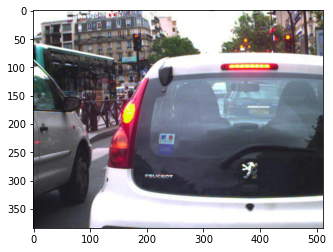

Target: 


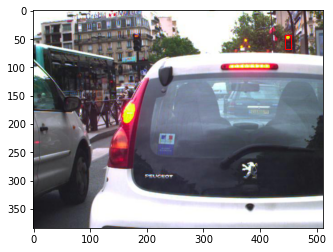

Confidence = 0.9958
Classification = 2
(tensor([0.0209, 0.8497, 0.0177, 0.0659, 0.7073], device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


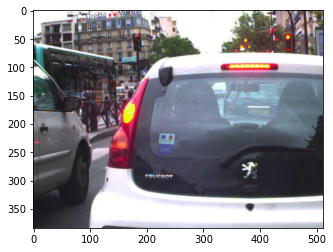

Target: 


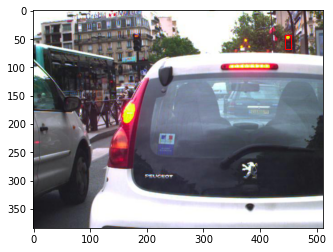

Confidence = 0.7073
Classification = 2
(tensor([0.4255, 0.2106, 0.0080, 0.0568, 0.5574], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


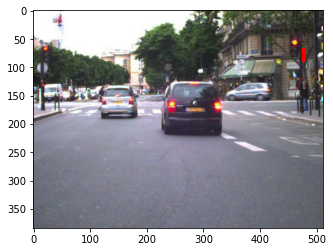

Target: 


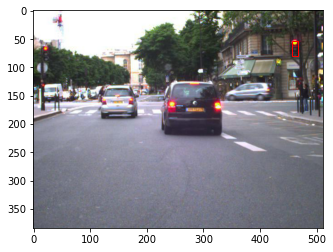

Confidence = 0.5574
Classification = 2
(tensor([0.8814, 0.4643, 0.0247, 0.0855, 0.5781], device='cuda:0'), tensor([[0., 6.]]), tensor(2, device='cuda:0'))


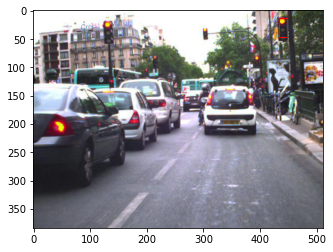

Target: 


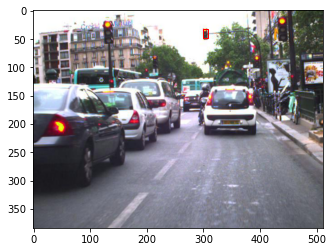

Confidence = 0.5781
Classification = 2
(tensor([0.9718, 0.7765, 0.0027, 0.0338, 0.8187], device='cuda:0'), tensor([[0., 6.]]), tensor(2, device='cuda:0'))


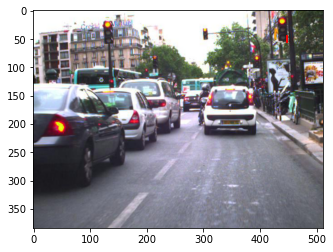

Target: 


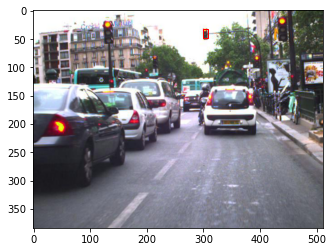

Confidence = 0.8187
Classification = 2
(tensor([0.6042, 0.5125, 0.0013, 0.0390, 0.7166], device='cuda:0'), tensor([[1., 7.]]), tensor(0, device='cuda:0'))


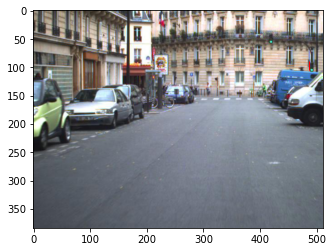

Target: 


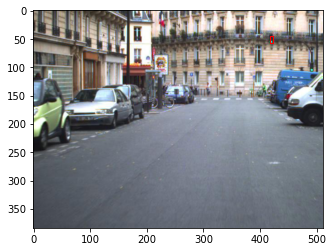

Confidence = 0.7166
Classification = 0
(tensor([0.4508, 0.3294, 0.0156, 0.0574, 0.8246], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


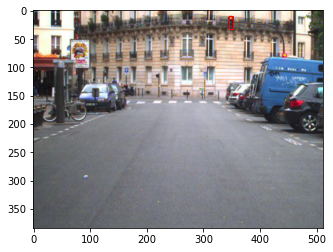

Target: 


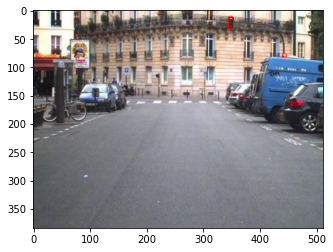

Confidence = 0.8246
Classification = 2
(tensor([0.2522, 0.3082, 0.0028, 0.0397, 0.9937], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


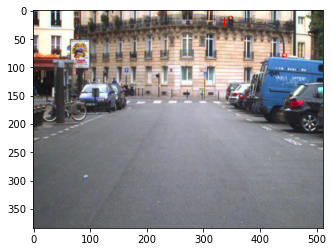

Target: 


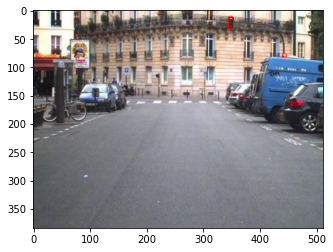

Confidence = 0.9937
Classification = 2
(tensor([0.6001, 0.4238, 0.0201, 0.0542, 0.7863], device='cuda:0'), tensor([[1., 4.]]), tensor(0, device='cuda:0'))


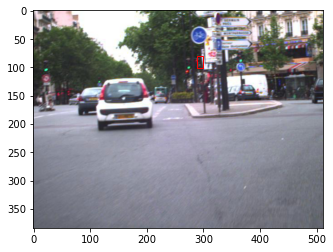

Target: 


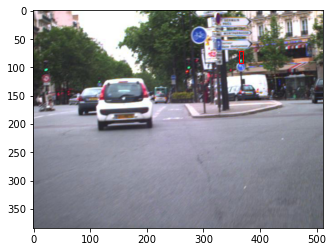

Confidence = 0.7863
Classification = 0
(tensor([0.7277, 0.3301, 0.0067, 0.0313, 0.5293], device='cuda:0'), tensor([[1., 4.]]), tensor(0, device='cuda:0'))


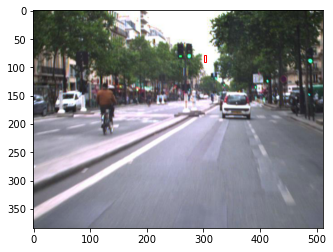

Target: 


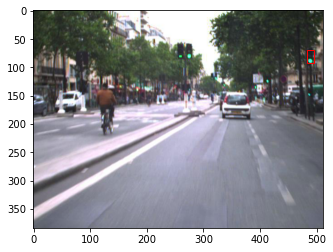

Confidence = 0.5293
Classification = 0
(tensor([9.6344e-01, 9.5897e-01, 5.7695e-04, 5.9563e-05, 5.2369e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


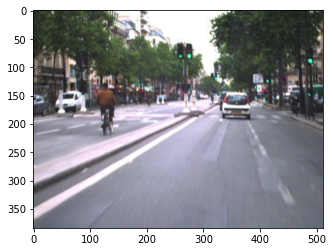

Target: 


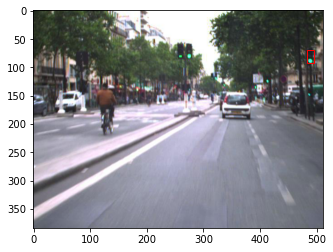

Confidence = 0.5237
Classification = 0
(tensor([0.8742, 0.4426, 0.0119, 0.0609, 0.6967], device='cuda:0'), tensor([[1., 3.]]), tensor(0, device='cuda:0'))


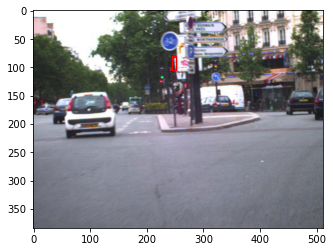

Target: 


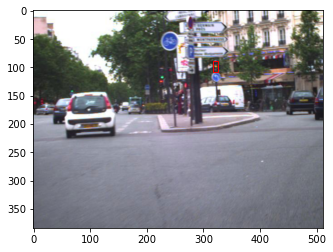

Confidence = 0.6967
Classification = 0
(tensor([0.4095, 0.1465, 0.0076, 0.0572, 0.8881], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


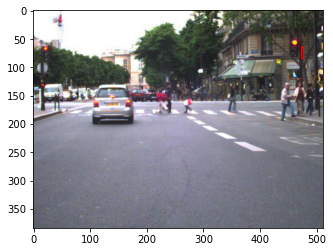

Target: 


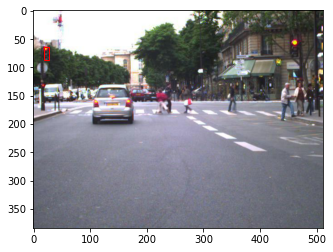

Confidence = 0.8881
Classification = 2
(tensor([0.7254, 0.2479, 0.0090, 0.0389, 0.7029], device='cuda:0'), tensor([[1., 7.]]), tensor(0, device='cuda:0'))


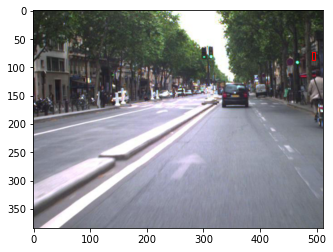

Target: 


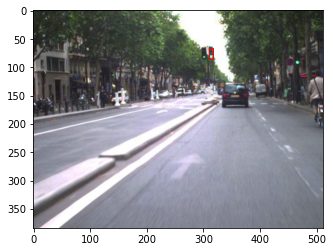

Confidence = 0.7029
Classification = 0
(tensor([0.0343, 0.0700, 0.0009, 0.0178, 0.5630], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


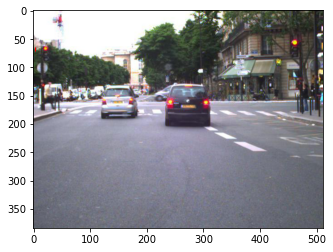

Target: 


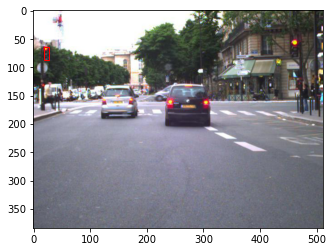

Confidence = 0.5630
Classification = 2
(tensor([0.4458, 0.3361, 0.0190, 0.0635, 0.7837], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


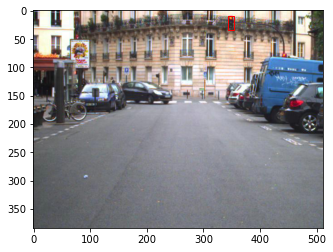

Target: 


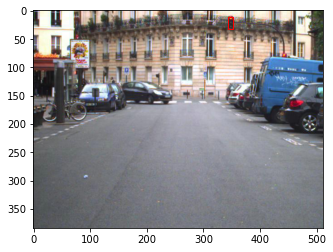

Confidence = 0.7837
Classification = 2
(tensor([0.2728, 0.3040, 0.0034, 0.0373, 0.9895], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


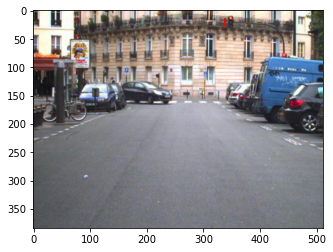

Target: 


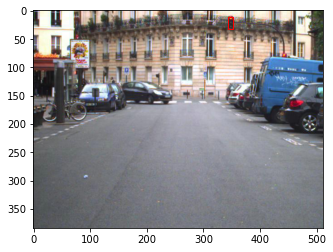

Confidence = 0.9895
Classification = 2
(tensor([0.0359, 0.1095, 0.0015, 0.0238, 0.5093], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


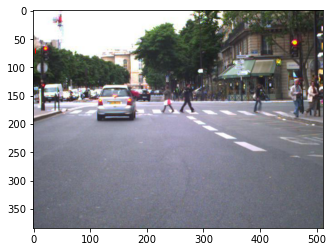

Target: 


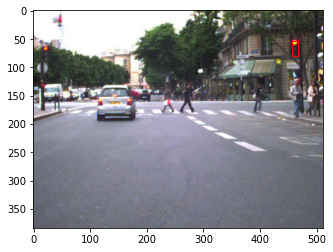

Confidence = 0.5093
Classification = 2
(tensor([0.8962, 0.0939, 0.0133, 0.0532, 0.6742], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


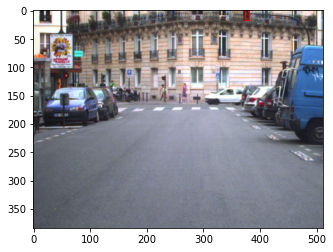

Target: 


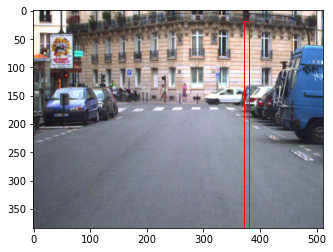

Confidence = 0.6742
Classification = 2
(tensor([0.2070, 0.1563, 0.0036, 0.0372, 0.9675], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


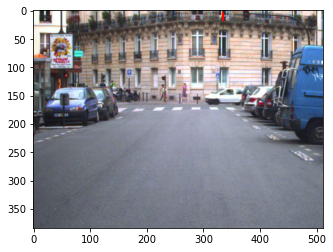

Target: 


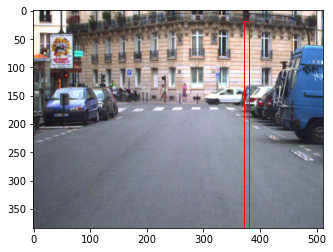

Confidence = 0.9675
Classification = 2
(tensor([0.1345, 0.2303, 0.0131, 0.0472, 0.7146], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


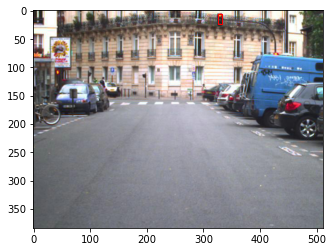

Target: 


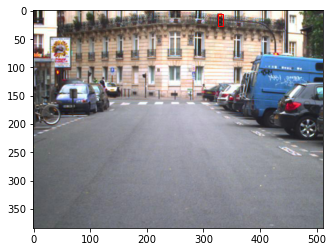

Confidence = 0.7146
Classification = 2
(tensor([0.1887, 0.2224, 0.0021, 0.0287, 0.9942], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


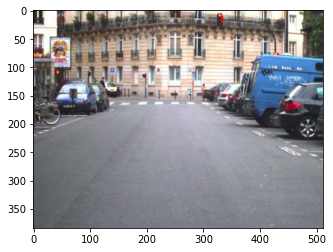

Target: 


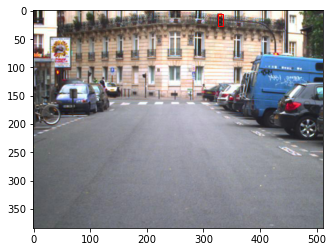

Confidence = 0.9942
Classification = 2
(tensor([2.0829e-02, 9.3041e-01, 8.4824e-05, 2.6262e-03, 9.9562e-01],
       device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


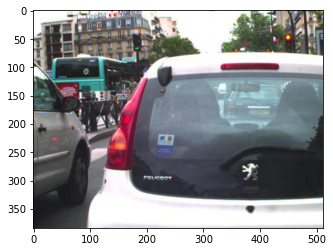

Target: 


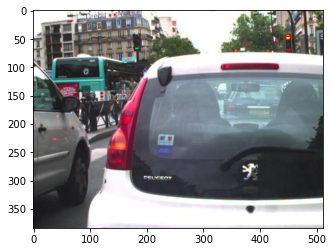

Confidence = 0.9956
Classification = 2
(tensor([0.0254, 0.8725, 0.0139, 0.0627, 0.6559], device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


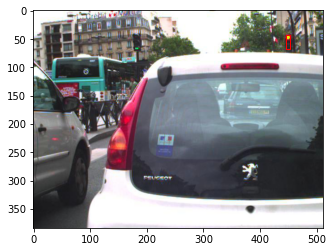

Target: 


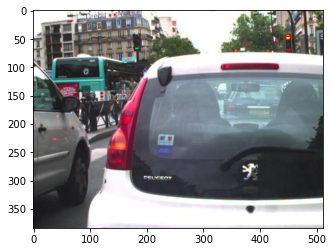

Confidence = 0.6559
Classification = 2
(tensor([0.5786, 0.6113, 0.0099, 0.0356, 0.6467], device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


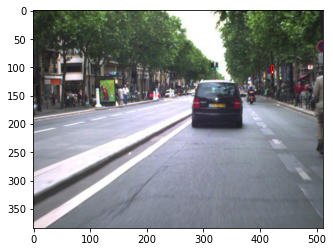

Target: 


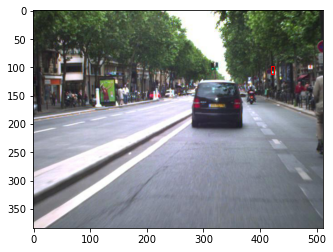

Confidence = 0.6467
Classification = 0
(tensor([9.5677e-01, 9.6706e-01, 8.2559e-04, 5.2156e-05, 9.8494e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


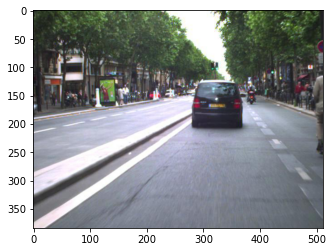

Target: 


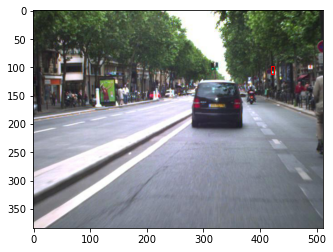

Confidence = 0.9849
Classification = 0
(tensor([0.4279, 0.3490, 0.0151, 0.0604, 0.7754], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


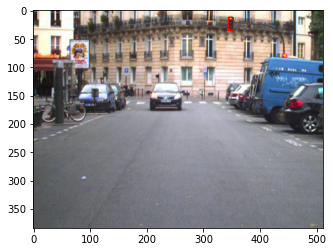

Target: 


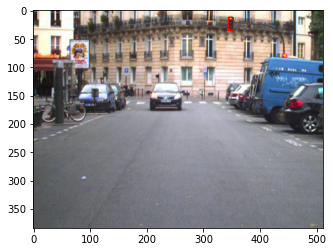

Confidence = 0.7754
Classification = 2
(tensor([0.2668, 0.2906, 0.0038, 0.0418, 0.9877], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


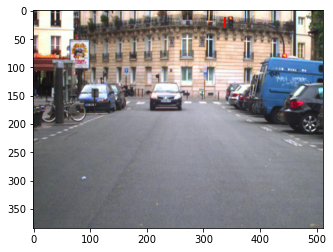

Target: 


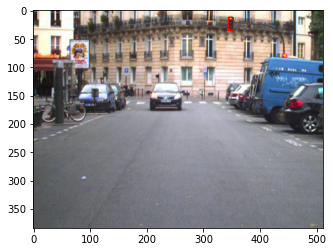

Confidence = 0.9877
Classification = 2
(tensor([0.6681, 0.2526, 0.0011, 0.0520, 0.9978], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


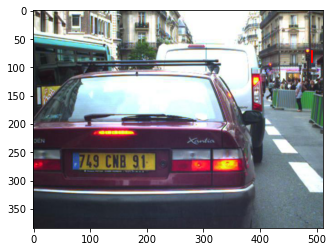

Target: 


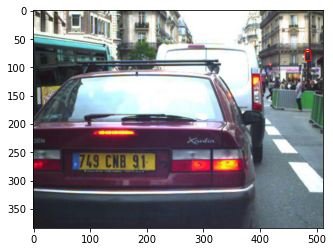

Confidence = 0.9978
Classification = 2
(tensor([0.5589, 0.2140, 0.0130, 0.0466, 0.7502], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


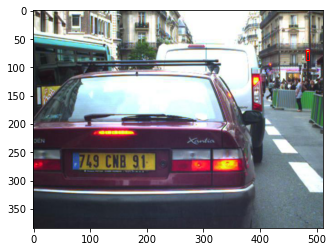

Target: 


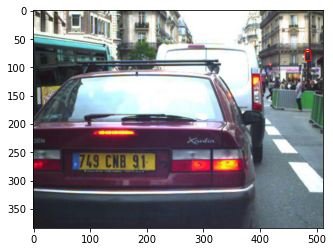

Confidence = 0.7502
Classification = 2
(tensor([0.4119, 0.3320, 0.0183, 0.0629, 0.8259], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


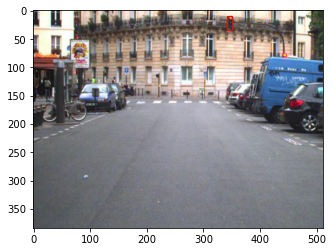

Target: 


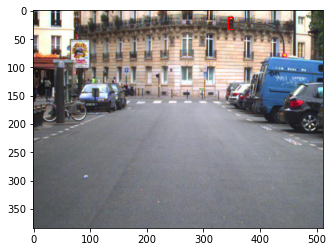

Confidence = 0.8259
Classification = 2
(tensor([0.2575, 0.3151, 0.0029, 0.0420, 0.9935], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


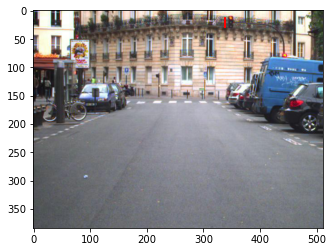

Target: 


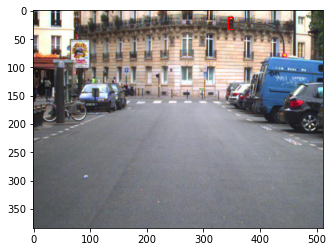

Confidence = 0.9935
Classification = 2
(tensor([0.4887, 0.1999, 0.0107, 0.0522, 0.8047], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


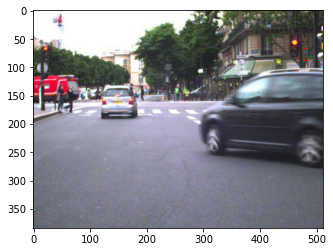

Target: 


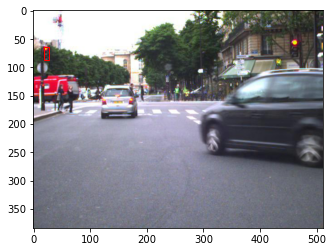

Confidence = 0.8047
Classification = 2
(tensor([0.4413, 0.3337, 0.0167, 0.0608, 0.8216], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


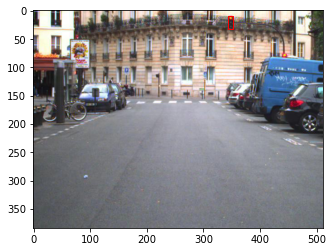

Target: 


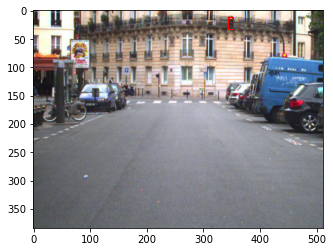

Confidence = 0.8216
Classification = 2
(tensor([0.2586, 0.3106, 0.0030, 0.0413, 0.9942], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


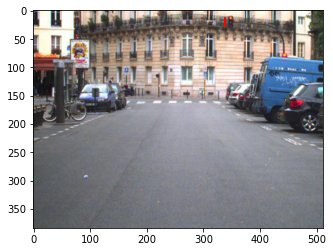

Target: 


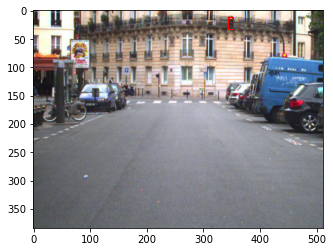

Confidence = 0.9942
Classification = 2
(tensor([0.4332, 0.3455, 0.0175, 0.0588, 0.8116], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


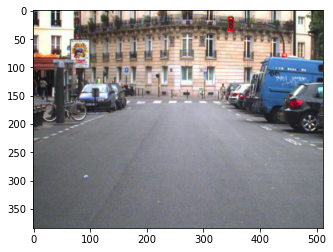

Target: 


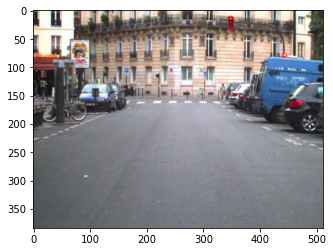

Confidence = 0.8116
Classification = 2
(tensor([0.2575, 0.3335, 0.0031, 0.0391, 0.9933], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


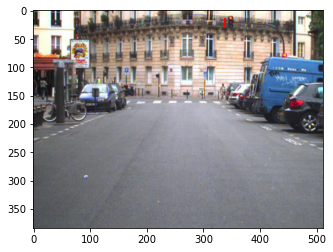

Target: 


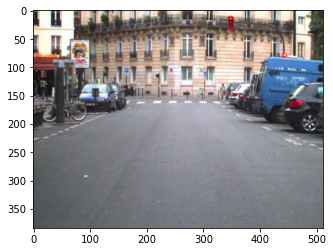

Confidence = 0.9933
Classification = 2
(tensor([2.0163e-02, 9.2984e-01, 7.4851e-05, 2.4406e-03, 9.9498e-01],
       device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


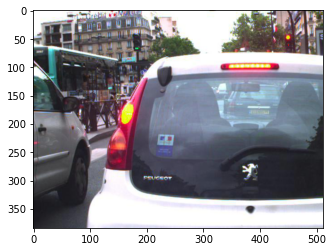

Target: 


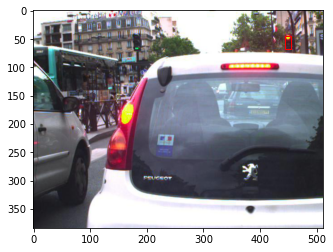

Confidence = 0.9950
Classification = 2
(tensor([0.0200, 0.8645, 0.0151, 0.0669, 0.6350], device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


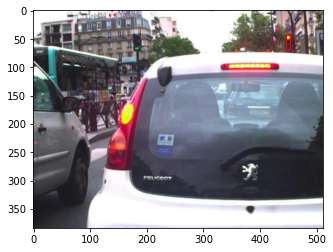

Target: 


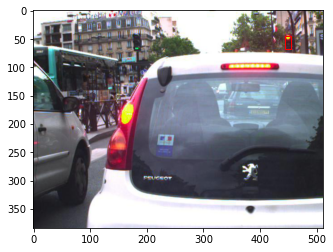

Confidence = 0.6350
Classification = 2
(tensor([0.4426, 0.3325, 0.0169, 0.0554, 0.8086], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


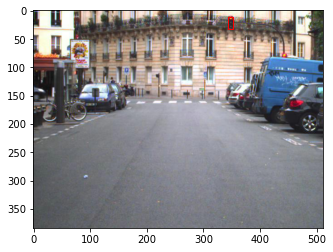

Target: 


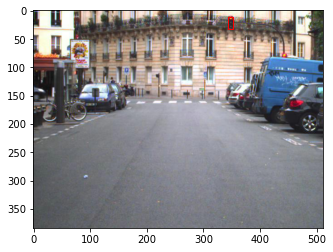

Confidence = 0.8086
Classification = 2
(tensor([0.2608, 0.3148, 0.0032, 0.0423, 0.9932], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


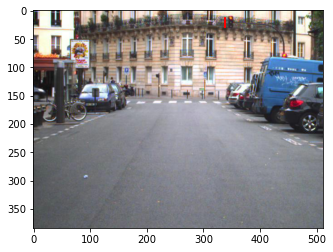

Target: 


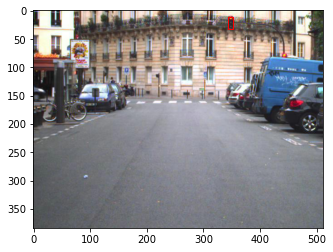

Confidence = 0.9932
Classification = 2
(tensor([9.1180e-01, 9.3524e-01, 2.1462e-03, 2.1877e-04, 5.1619e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(3, device='cuda:0'))


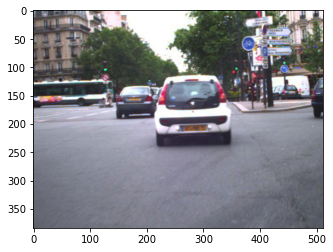

Target: 


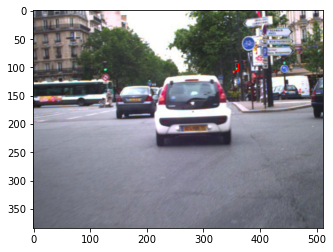

Confidence = 0.5162
Classification = 3
(tensor([9.7269e-01, 9.7233e-01, 4.3257e-04, 2.6838e-05, 9.1857e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


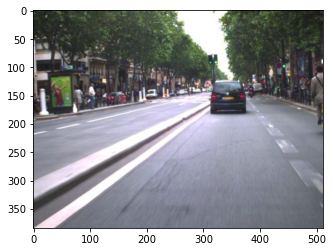

Target: 


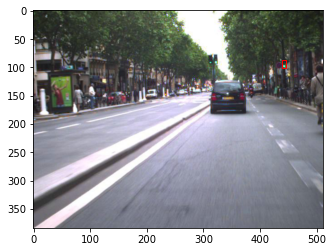

Confidence = 0.9186
Classification = 0
(tensor([0.4320, 0.9540, 0.0101, 0.0298, 0.5993], device='cuda:0'), tensor([[0., 6.]]), tensor(0, device='cuda:0'))


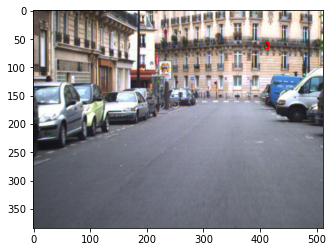

Target: 


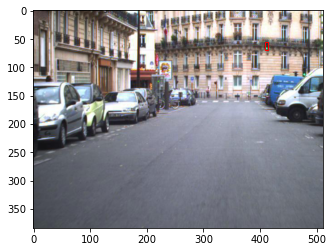

Confidence = 0.5993
Classification = 0
(tensor([9.8409e-01, 7.1157e-01, 8.0240e-04, 1.5202e-02, 8.9264e-01],
       device='cuda:0'), tensor([[0., 6.]]), tensor(0, device='cuda:0'))


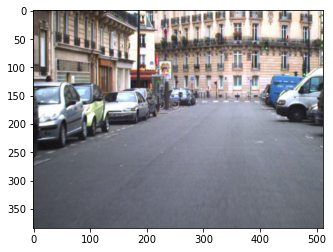

Target: 


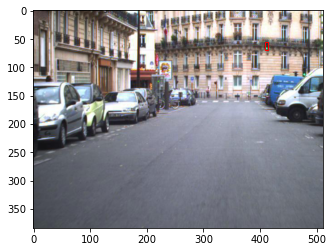

Confidence = 0.8926
Classification = 0
(tensor([0.5307, 0.7249, 0.0011, 0.0337, 0.6902], device='cuda:0'), tensor([[1., 7.]]), tensor(0, device='cuda:0'))


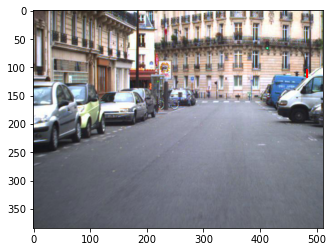

Target: 


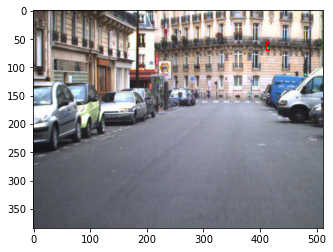

Confidence = 0.6902
Classification = 0
(tensor([0.3435, 0.0623, 0.0180, 0.0533, 0.6545], device='cuda:0'), tensor([[1., 6.]]), tensor(2, device='cuda:0'))


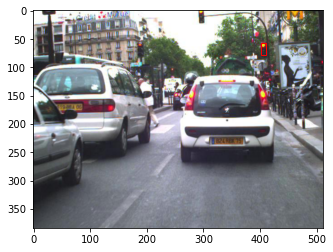

Target: 


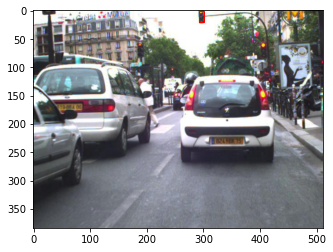

Confidence = 0.6545
Classification = 2
(tensor([9.4189e-01, 9.3625e-01, 1.8585e-03, 7.6116e-05, 8.8410e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(2, device='cuda:0'))


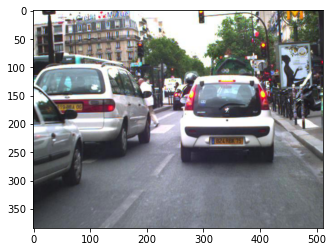

Target: 


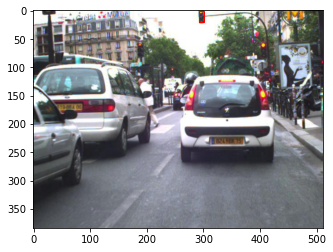

Confidence = 0.8841
Classification = 2
(tensor([0.4714, 0.3385, 0.0167, 0.0584, 0.8036], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


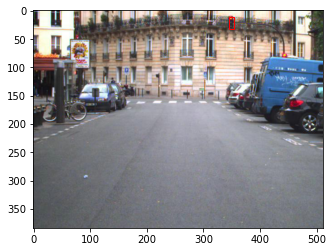

Target: 


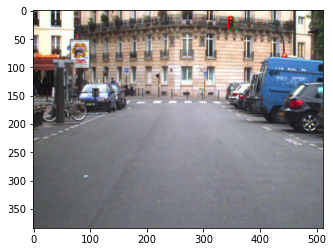

Confidence = 0.8036
Classification = 2
(tensor([0.2631, 0.3134, 0.0029, 0.0402, 0.9933], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


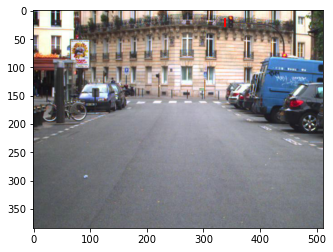

Target: 


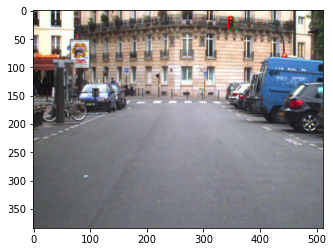

Confidence = 0.9933
Classification = 2
(tensor([0.5780, 0.1641, 0.0125, 0.0587, 0.7720], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


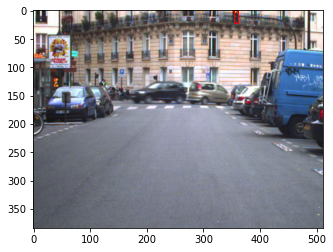

Target: 


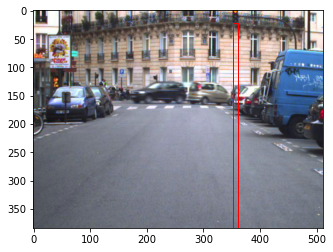

Confidence = 0.7720
Classification = 2
(tensor([0.2191, 0.1584, 0.0033, 0.0345, 0.9950], device='cuda:0'), tensor([[0., 5.]]), tensor(2, device='cuda:0'))


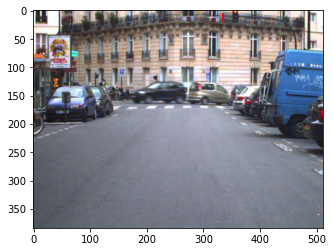

Target: 


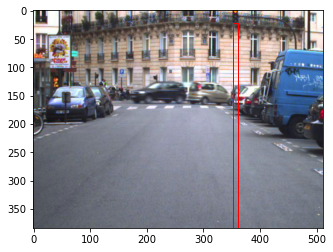

Confidence = 0.9950
Classification = 2
(tensor([0.1205, 0.9744, 0.0218, 0.0614, 0.5177], device='cuda:0'), tensor([[0., 6.]]), tensor(2, device='cuda:0'))


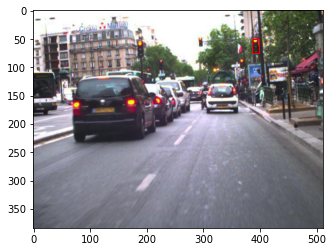

Target: 


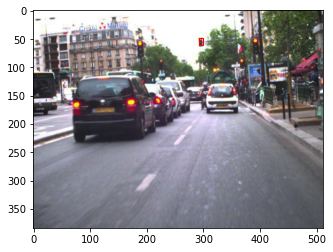

Confidence = 0.5177
Classification = 2
(tensor([0.9785, 0.8024, 0.0032, 0.0422, 0.8460], device='cuda:0'), tensor([[0., 6.]]), tensor(2, device='cuda:0'))


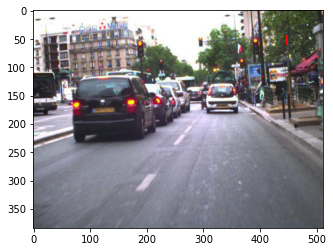

Target: 


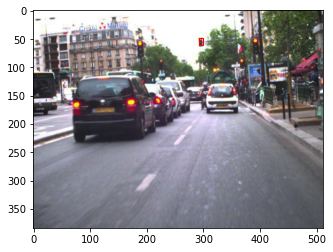

Confidence = 0.8460
Classification = 2
(tensor([2.6422e-02, 9.2836e-01, 1.4240e-04, 2.6048e-03, 9.9657e-01],
       device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


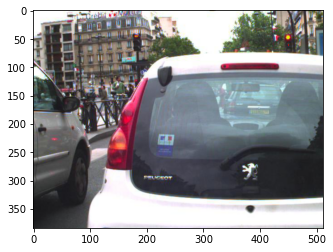

Target: 


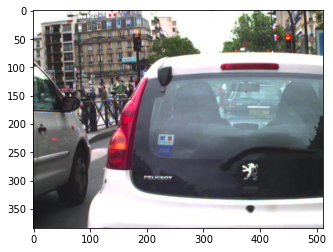

Confidence = 0.9966
Classification = 2
(tensor([0.0298, 0.8705, 0.0209, 0.0732, 0.7744], device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


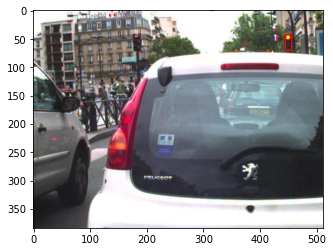

Target: 


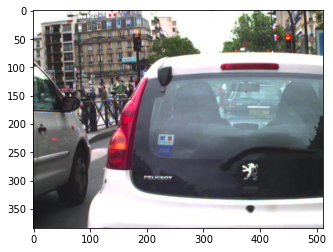

Confidence = 0.7744
Classification = 2
(tensor([0.3586, 0.1729, 0.0115, 0.0527, 0.5399], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


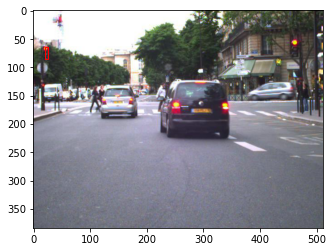

Target: 


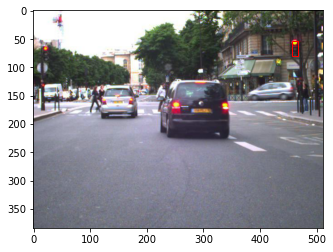

Confidence = 0.5399
Classification = 2
(tensor([0.0413, 0.0816, 0.0009, 0.0197, 0.7898], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


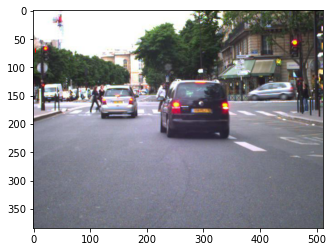

Target: 


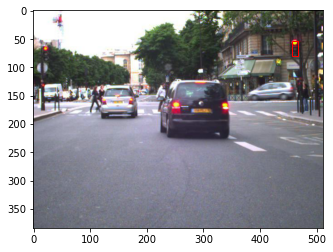

Confidence = 0.7898
Classification = 2
(tensor([0.4222, 0.1673, 0.0089, 0.0595, 0.6834], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


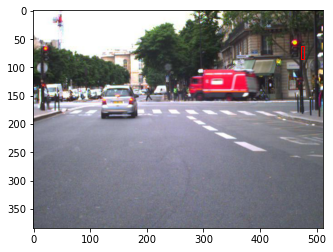

Target: 


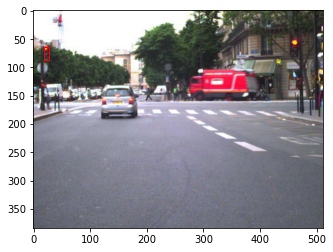

Confidence = 0.6834
Classification = 2
(tensor([0.2657, 0.0641, 0.0100, 0.0385, 0.5792], device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


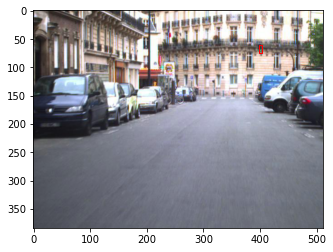

Target: 


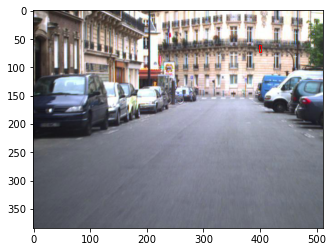

Confidence = 0.5792
Classification = 0
(tensor([9.4845e-01, 9.4460e-01, 4.9880e-04, 3.1630e-05, 9.4543e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(0, device='cuda:0'))


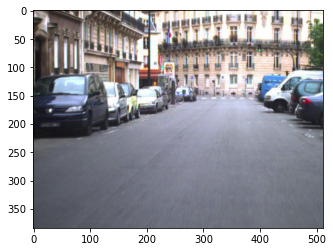

Target: 


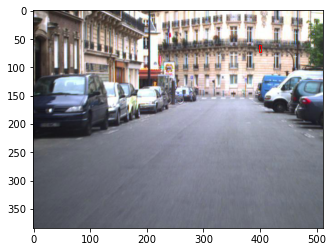

Confidence = 0.9454
Classification = 0
(tensor([0.0468, 0.1196, 0.0021, 0.0204, 0.6246], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


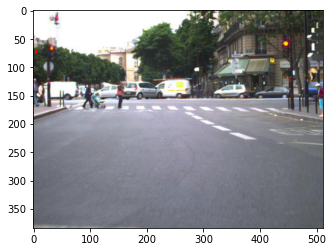

Target: 


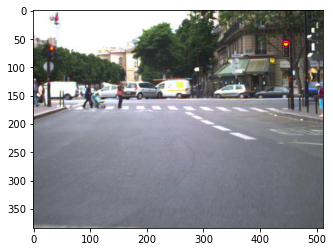

Confidence = 0.6246
Classification = 2
(tensor([0.8969, 0.5020, 0.0193, 0.0499, 0.6592], device='cuda:0'), tensor([[1., 5.]]), tensor(2, device='cuda:0'))


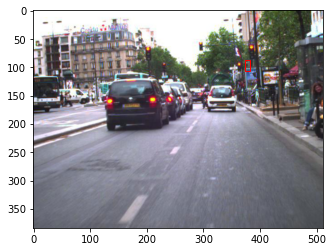

Target: 


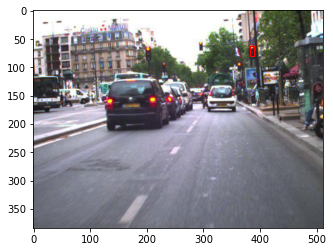

Confidence = 0.6592
Classification = 2
(tensor([0.0533, 0.4249, 0.0118, 0.0554, 0.5002], device='cuda:0'), tensor([[0., 4.]]), tensor(2, device='cuda:0'))


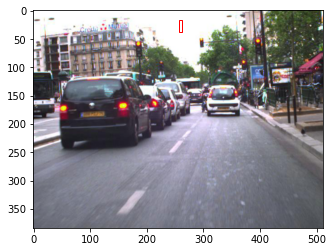

Target: 


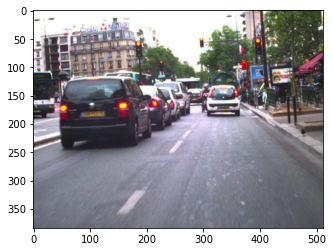

Confidence = 0.5002
Classification = 2
(tensor([6.4994e-01, 2.5108e-01, 9.7831e-04, 6.0494e-02, 9.9792e-01],
       device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


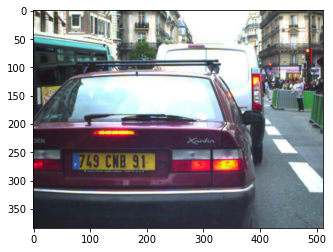

Target: 


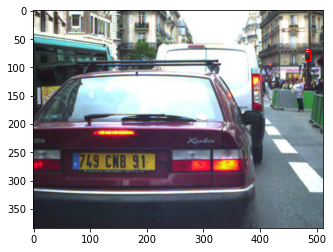

Confidence = 0.9979
Classification = 2
(tensor([0.5602, 0.2203, 0.0151, 0.0472, 0.7371], device='cuda:0'), tensor([[1., 7.]]), tensor(2, device='cuda:0'))


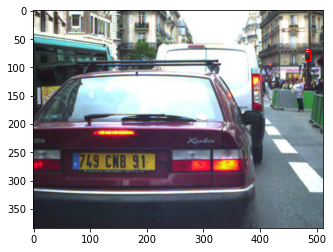

Target: 


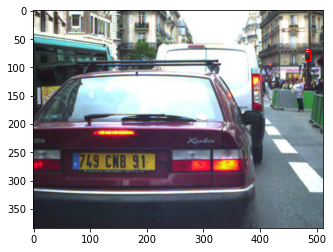

Confidence = 0.7371
Classification = 2
(tensor([0.2571, 0.2349, 0.0021, 0.0852, 0.7671], device='cuda:0'), tensor([[1., 7.]]), tensor(3, device='cuda:0'))


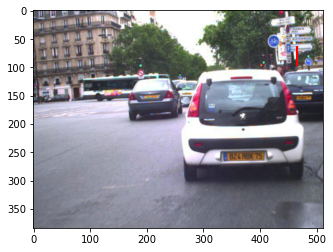

Target: 


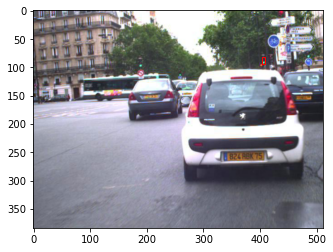

Confidence = 0.7671
Classification = 3
(tensor([0.5932, 0.1782, 0.0135, 0.0377, 0.6905], device='cuda:0'), tensor([[1., 7.]]), tensor(3, device='cuda:0'))


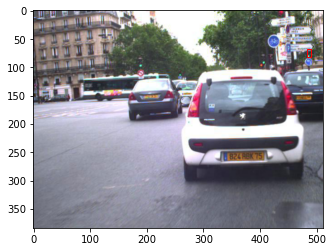

Target: 


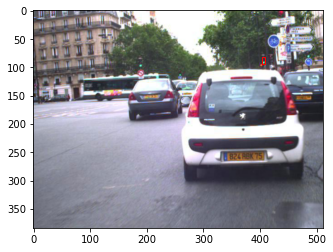

Confidence = 0.6905
Classification = 3
(tensor([1.9481e-02, 9.3860e-01, 1.0250e-04, 2.2667e-03, 9.9669e-01],
       device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


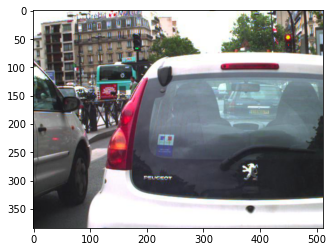

Target: 


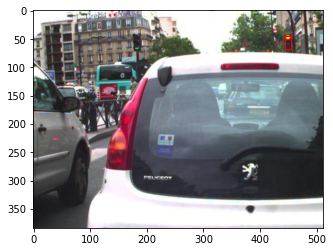

Confidence = 0.9967
Classification = 2
(tensor([0.0212, 0.8721, 0.0158, 0.0596, 0.7557], device='cuda:0'), tensor([[0., 7.]]), tensor(2, device='cuda:0'))


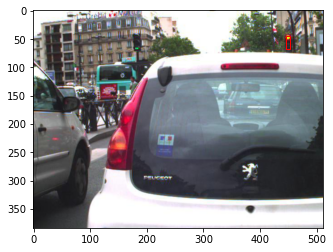

Target: 


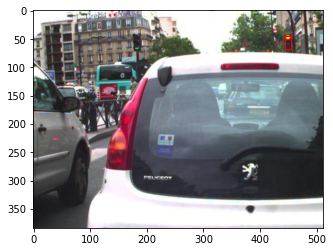

Confidence = 0.7557
Classification = 2
(tensor([0.0287, 0.1026, 0.0013, 0.0206, 0.5535], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


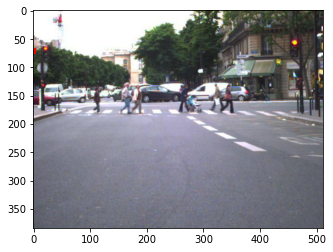

Target: 


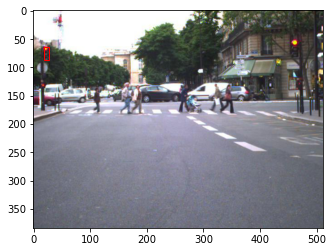

Confidence = 0.5535
Classification = 2
(tensor([9.4675e-01, 9.0185e-01, 2.7470e-03, 8.5226e-05, 5.2899e-01],
       device='cuda:0'), tensor([[1., 6.]]), tensor(2, device='cuda:0'))


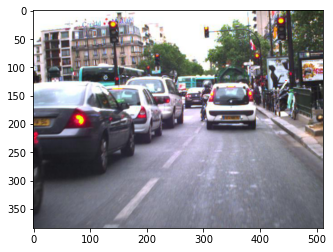

Target: 


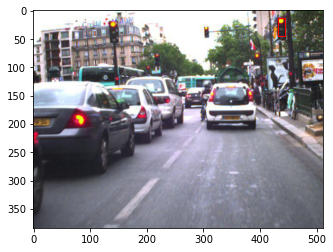

Confidence = 0.5290
Classification = 2
(tensor([0.0469, 0.0893, 0.0009, 0.0178, 0.6719], device='cuda:0'), tensor([[1., 0.]]), tensor(2, device='cuda:0'))


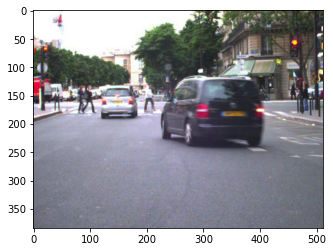

Target: 


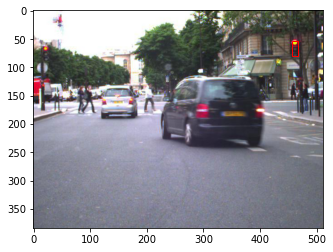

Confidence = 0.6719
Classification = 2
(tensor([0.6954, 0.7232, 0.0123, 0.0338, 0.5898], device='cuda:0'), tensor([[0., 6.]]), tensor(0, device='cuda:0'))


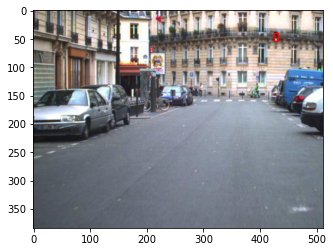

Target: 


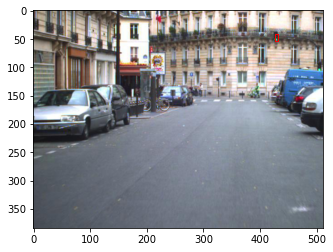

Confidence = 0.5898
Classification = 0
(tensor([0.9777, 0.7494, 0.0010, 0.0160, 0.9277], device='cuda:0'), tensor([[0., 6.]]), tensor(0, device='cuda:0'))


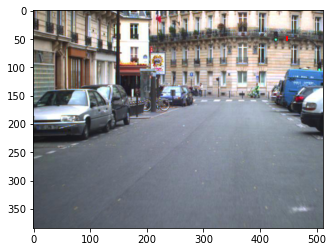

Target: 


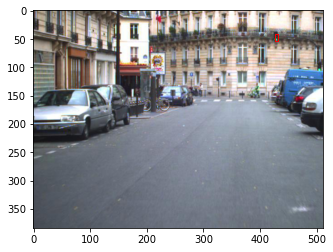

Confidence = 0.9277
Classification = 0
(tensor([0.5370, 0.7667, 0.0167, 0.0610, 0.5903], device='cuda:0'), tensor([[0., 4.]]), tensor(2, device='cuda:0'))


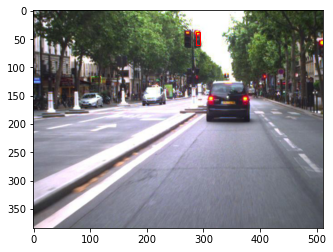

Target: 


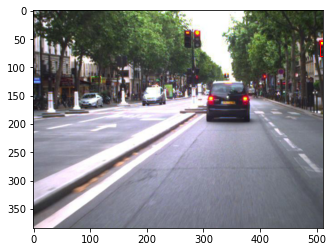

Confidence = 0.5903
Classification = 2
(tensor([0.0484, 0.3130, 0.0080, 0.0277, 0.7985], device='cuda:0'), tensor([[0., 4.]]), tensor(2, device='cuda:0'))


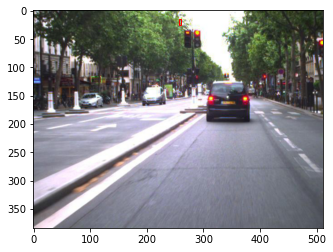

Target: 


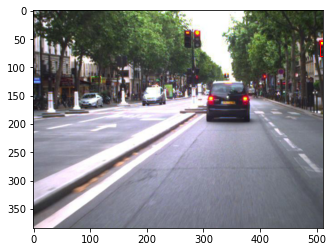

Confidence = 0.7985
Classification = 2
(tensor([0.4339, 0.5555, 0.0149, 0.0754, 0.6438], device='cuda:0'), tensor([[0., 4.]]), tensor(0, device='cuda:0'))


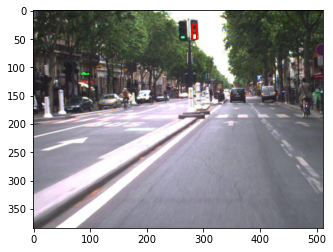

Target: 


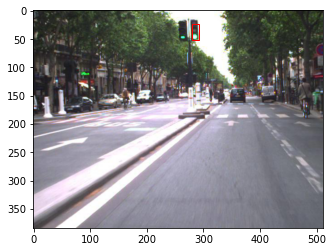

Confidence = 0.6438
Classification = 0
(tensor([0.0366, 0.3709, 0.0042, 0.0430, 0.9629], device='cuda:0'), tensor([[0., 4.]]), tensor(0, device='cuda:0'))


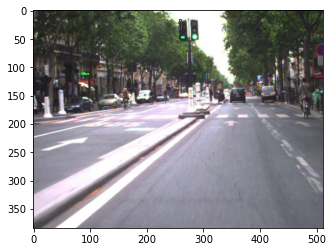

Target: 


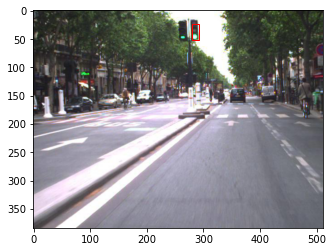

Confidence = 0.9629
Classification = 0


In [11]:
torch.cuda.empty_cache()
test_show(net, device, valid_loader)

In [10]:
%%time
torch.cuda.empty_cache()
validate('', net, device, test_loader)

...............Validation/Test: IoU = 0.0000, mAP = 0.0000, Accu = 0.0000
CPU times: user 1min 27s, sys: 19.5 s, total: 1min 46s
Wall time: 26.6 s


(0.0, 0.0, 0.0)

In [12]:
torch.save(net.state_dict(), './save_0.0007_0.00025')

In [7]:
net = network.Yolo()
net.load_state_dict(torch.load('./save_0.0007_0.00025'))
net.cuda()

Yolo(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(2, 2))
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (leaky1): LeakyReLU(negative_slope=0.1)
  (maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
  (bn2): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (leaky2): LeakyReLU(negative_slope=0.1)
  (maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (block1): Sequential(
    (0): Conv2d(192, 128, kernel_size=(1, 1), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.1)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.1)
    (5): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (6):

Text(0.5, 1.0, 'Validation mAP over Epochs')

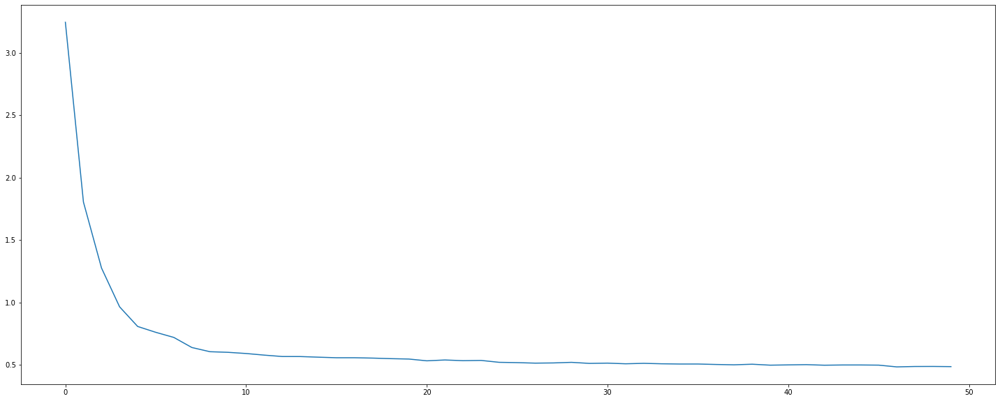

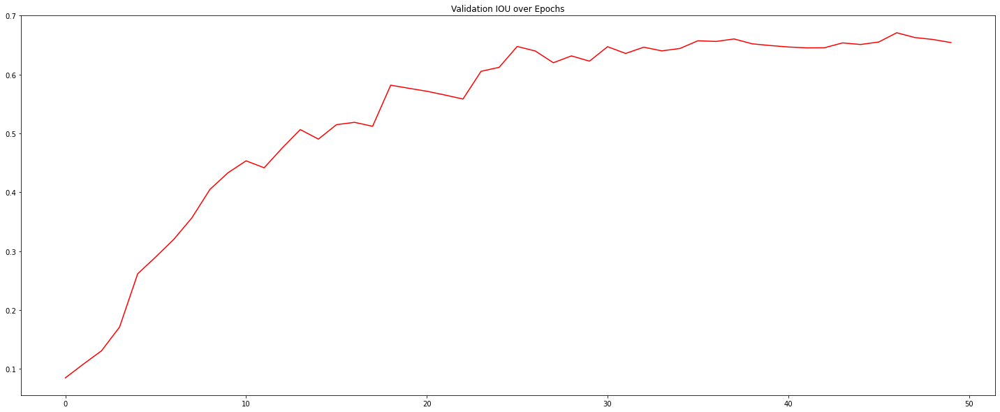

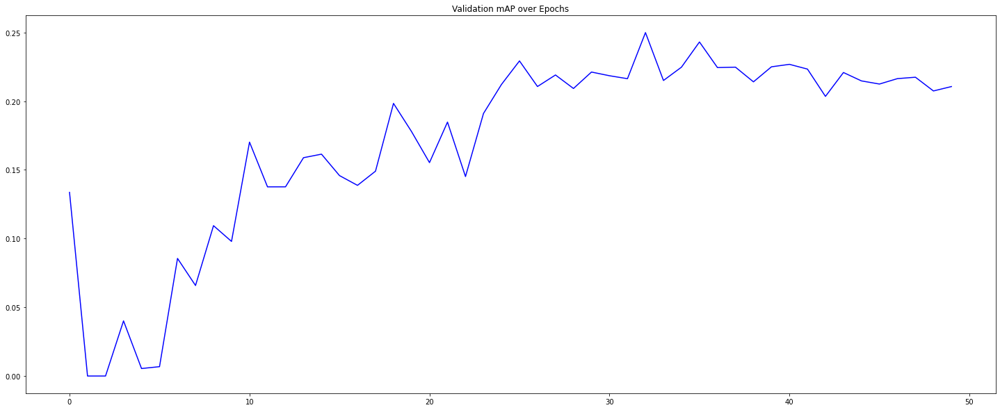

In [8]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(25, 10))
plt.plot(losses)
fig2 = plt.figure(figsize=(25, 10))
plt.plot(val_IoUs, color='r')
plt.title("Validation IOU over Epochs")
fig3 = plt.figure(figsize=(25, 10))
plt.plot(val_mAPs, color = 'b')
plt.title("Validation mAP over Epochs")